# ECS7020P mini-project submission

The mini-project has two separate components:


1.   **Basic component** [6 marks]: Using the MLEnd London Sounds dataset, build a machine learning pipeline that takes as an input an audio segment and predicts whether the audio segment has been recorded indoors or outdoors.
2.   **Advanced component** [10 marks]: Formulate your own machine learning problem and build a machine learning solution using the MLEnd London Sounds dataset. 

Your submission will consist of two Jupyter notebooks, one for the basic component and another one for advanced component. Please **name each notebook**:

* ECS7020P_miniproject_basic.ipynb
* ECS7020P_miniproject_advanced.ipynb

then **zip and submit them toghether**.

Each uploaded notebook should include: 

*   **Text cells**, describing concisely each step and results.
*   **Code cells**, implementing each step.
*   **Output cells**, i.e. the output from each code cell.

and **should have the structure** indicated below. Notebooks might not be run, please make sure that the output cells are saved.

How will we evaluate your submission?

*   Conciseness in your writing (10%).
*   Correctness in your methodology (30%).
*   Correctness in your analysis and conclusions (30%).
*   Completeness (10%).
*   Originality (10%).
*   Efforts to try something new (10%).

Suggestion: Why don't you use **GitHub** to manage your project? GitHub can be used as a presentation card that showcases what you have done and gives evidence of your data science skills, knowledge and experience. 

Each notebook should be structured into the following 9 sections:


# 1 Author

**Student Name**:  Karan Kaus
**Student ID**:  



# 2 Problem formulation

Describe the machine learning problem that you want to solve and explain what's interesting about it.

# 3 Machine Learning pipeline

Describe your ML pipeline. Clearly identify its input and output, any intermediate stages (for instance, transformation -> models), and intermediate data moving from one stage to the next. It's up to you to decide which stages to include in your pipeline. 

# 4 Transformation stage

Describe any transformations, such as feature extraction. Identify input and output. Explain why you have chosen this transformation stage.

# 5 Modelling

Describe the ML model(s) that you will build. Explain why you have chosen them.

# 6 Methodology

Describe how you will train and validate your models, how model performance is assesssed (i.e. accuracy, confusion matrix, etc)

# 7 Dataset

Describe the dataset that you will use to create your models and validate them. If you need to preprocess it, do it here. Include visualisations too. You can visualise raw data samples or extracted features.

In [30]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import librosa.display
import math

import os, sys, re, pickle, glob
import urllib.request
import zipfile

import IPython.display as ipd
from tqdm import tqdm
import librosa
import scipy.stats as stats

from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import make_column_transformer

In [24]:
sample_path = 'MLEndLS/*.wav'
files = glob.glob(sample_path)
MLENDLS_df = pd.read_csv('./MLEndLS.csv').set_index('file_id') 

In [29]:
column_transformer = make_column_transformer(
    (OneHotEncoder(), ['in_out', 'area']),
    remainder='passthrough',
    verbose_feature_names_out=False
)

input_data = column_transformer.fit_transform(MLENDLS_df)
input_data = pd.DataFrame(data=input_data, columns=column_transformer.get_feature_names_out())

labels = MLENDLS_df['spot'].to_numpy()

input_data = input_data.drop(columns=[
    'Participant',
    'spot',
])

display(input_data)
display(labels)

,in_out_indoor,in_out_outdoor,area_Euston,area_british,area_campus,area_kensington,area_southbank,area_westend
0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
3,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...
2495,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
2496,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
2497,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2498,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


array(['street', 'dinosaur', 'square', ..., 'national', 'room12',
       'room12'], dtype=object)

area            campus
spot            square
in_out         outdoor
Participant       S122
Name: 1864.wav, dtype: object

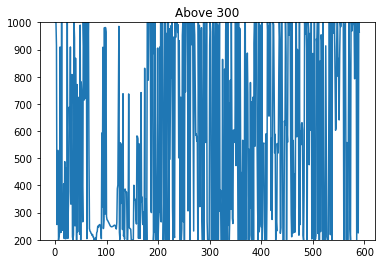

area           campus
spot            curve
in_out         indoor
Participant      S145
Name: 0970.wav, dtype: object

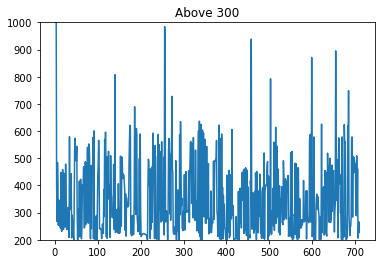

area            westend
spot           national
in_out           indoor
Participant        S189
Name: 2113.wav, dtype: object

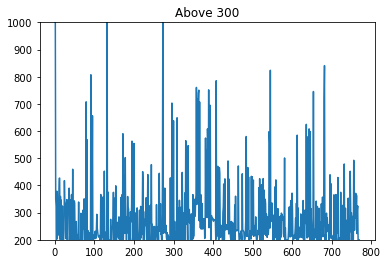

area            campus
spot             canal
in_out         outdoor
Participant       S164
Name: 0212.wav, dtype: object

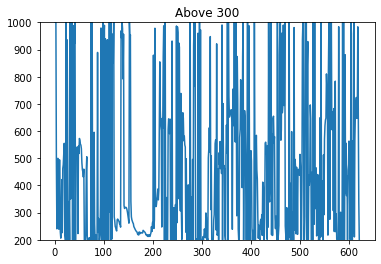

area            campus
spot            square
in_out         outdoor
Participant        S11
Name: 0239.wav, dtype: object

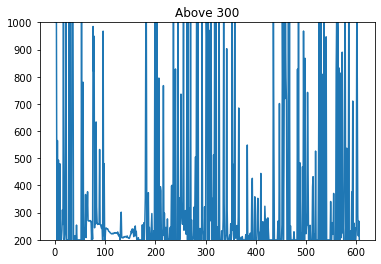

area             westend
spot           trafalgar
in_out           outdoor
Participant          S66
Name: 1994.wav, dtype: object

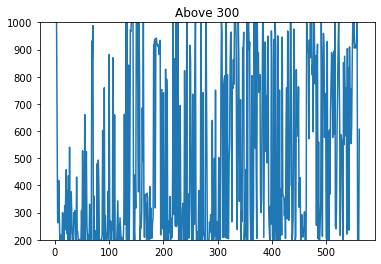

area           british
spot            square
in_out         outdoor
Participant        S51
Name: 1884.wav, dtype: object

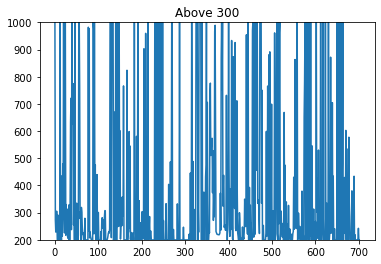

area            westend
spot           national
in_out           indoor
Participant        S157
Name: 0506.wav, dtype: object

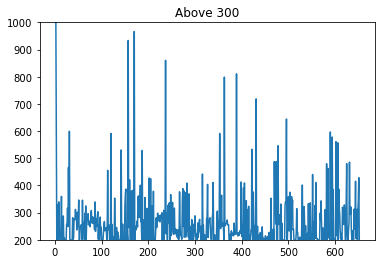

area            Euston
spot           ritblat
in_out          indoor
Participant       S186
Name: 1704.wav, dtype: object

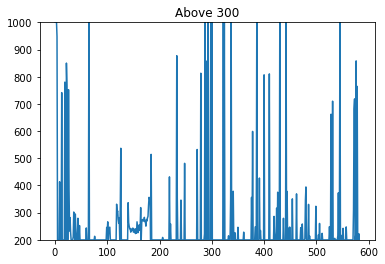

area            campus
spot             canal
in_out         outdoor
Participant         S3
Name: 1214.wav, dtype: object

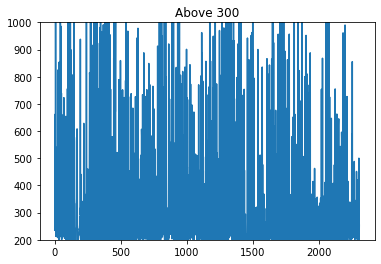

area           campus
spot            curve
in_out         indoor
Participant       S35
Name: 1682.wav, dtype: object

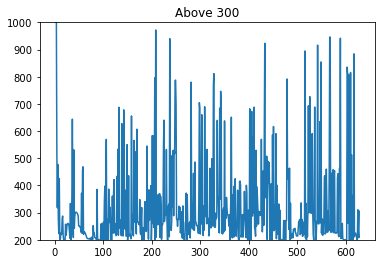

area             westend
spot           trafalgar
in_out           outdoor
Participant         S147
Name: 0632.wav, dtype: object

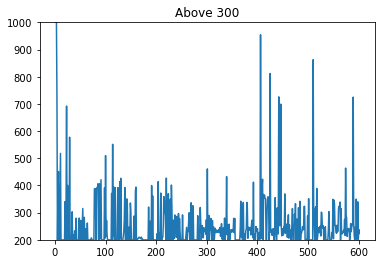


Done


In [104]:
import matplotlib.pyplot as plt

aud_data = []
labels = []

def getPitch(x,fs,winLen=0.02):
    #winLen = 0.02 
    p = winLen*fs
    frame_length = int(2**int(p-1).bit_length())
    hop_length = frame_length//2
    f0 = librosa.yin(y=x, fmin=200, fmax=1000, sr=fs,
                      frame_length=frame_length,hop_length=hop_length)
    
    plt.ylim(200,1000)
    plt.plot(list(range(0,len(f0))), f0)
    plt.title("Above 300")
    plt.show()

    return f0
    
for n in range(0,int(len(files)/200)):
# for n in range(15,150):
    file_name = files[n]
    a, fs = librosa.load(file_name, sr=None)

    p = 0.02*fs
    frame_length = int(2**int(p-1).bit_length())
    hop_length = frame_length//2
    
    meta = MLENDLS_df.loc[files[n].split('/')[-1]]
    display(meta)
    display(ipd.Audio(files[n]))

    f0 = None
#     if True:
    try:
        f0 = getPitch(a,fs,winLen=0.02)
        pass
    except:
        print("Invalid file", file_name)
        continue
    
    # Filtering errored/invalid data
    if len(S) < 90*536 : continue
    if (n%100 == 0) : print(n,'/',len(files),end="\r")

    aud_data.append(S)
    labels.append(MLENDLS_df.loc[files[n].split('/')[-1]].in_out)

print("\nDone")

In [4]:
import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

numComponents = 5
pca = PCA(n_components=numComponents)
pca.fit(aud_data)

projected = pca.transform(aud_data)
projected = pd.DataFrame(projected,columns=['pc1','pc2','pc3','pc4','pc5'],index=range(1,len(aud_data)+1))
# projected['label'] = labels
display(projected)

,pc1,pc2,pc3,pc4,pc5
1,-225.875466,-30.414097,-24.801060,-98.045542,24.199127
2,-109.298090,-133.198253,17.015147,27.954434,40.171965
3,-246.337859,27.005779,-12.768935,51.204619,50.171117
4,-213.374926,69.486009,187.112356,-108.248590,-117.800435
5,-300.415214,-2.595172,-1.983541,-20.964520,8.424383
...,...,...,...,...,...
2475,-277.373929,14.298521,-38.487499,-36.464207,64.735095
2476,106.790441,-46.195615,-81.703454,-39.566134,72.423692
2477,-177.154952,-23.065456,-53.507593,1.942786,68.975845
2478,-80.723152,-25.413384,-73.534039,-160.279610,84.672674


In [15]:
projected = projected.drop(columns=[
#     'pc3',
#     'pc4',
#     'pc5',
#     'pc6',
#     'pc7'
])

In [12]:
from sklearn.model_selection import GridSearchCV, train_test_split

X_train, X_val, y_train, y_val = train_test_split(projected,labels,test_size=0.2)
print(X_train.shape, X_val.shape)

(1983, 3) (496, 3)


# 8 Results

Carry out your experiments here, explain your results.

In [16]:
from sklearn import svm

parameters = {'C':[1,2,3,4,5]}

svc = svm.SVC()
clf = GridSearchCV(svc, parameters,cv=5)

clf.fit(X_train,y_train)

print('Hyperparameters: ', clf.best_estimator_)
print('Average accuracy: ', clf.best_score_)
print('Test dataset accuracy:', clf.score(X_val, y_val))

Hyperparameters:  SVC(C=5)
Average accuracy:  0.636405617891764
Test dataset accuracy: 0.6290322580645161


In [17]:
parameters = {'n_estimators':[50,200,300,500], 'max_features':[0.1,0.5,1,2], 'max_depth':[7,8]}

rfc = RandomForestClassifier(max_depth=7)
clf = GridSearchCV(rfc, parameters,cv=5)

clf.fit(X_train,y_train)

print('Hyperparameters: ', clf.best_estimator_)
print('Average accuracy: ', clf.best_score_)
print('Test dataset accuracy:', clf.score(X_val, y_val))

Hyperparameters:  RandomForestClassifier(max_depth=7, max_features=0.5, n_estimators=300)
Average accuracy:  0.632369030353917
Test dataset accuracy: 0.6391129032258065


  
  
--------------------------------------
--------------------------------------
--------------------------------------
  
  
  

In [ ]:
from sklearn.metrics import confusion_matrix

train_confusion_matrix = confusion_matrix(y_true=y_train, y_pred=log_reg_classifier.predict(x_train))
train_confusion_matrix_normalised = train_confusion_matrix.astype('float') / train_confusion_matrix.sum(axis=1)[:, np.newaxis]

val_confusion_matrix = confusion_matrix(y_true=y_val, y_pred=log_reg_classifier.predict(x_val))
val_confusion_matrix_normalised = val_confusion_matrix.astype('float') / val_confusion_matrix.sum(axis=1)[:, np.newaxis]

print('Training confusion matrix:\n {}\n'.format(train_confusion_matrix))
print('Validation confusion matrix:\n {}\n'.format(val_confusion_matrix))

print('Normalised training confusion matrix:\n {}\n'.format(train_confusion_matrix_normalised))
print('Normalised validation confusion matrix:\n {}\n'.format(val_confusion_matrix_normalised))

In [9]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification

from sklearn.model_selection import GridSearchCV, train_test_split

X_train, X_val, y_train, y_val = train_test_split(projected,labels,test_size=0.2)
print(X_train.shape, X_val.shape)

clf = RandomForestClassifier(max_depth=7)
clf.fit(X_train,y_train)

yt_p = clf.predict(X_train)
yv_p = clf.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))

(1983, 5) (496, 5)
Training Accuracy 0.762481089258699
Validation  Accuracy 0.6512096774193549


In [267]:
model  = svm.SVC(C=1)
model.fit(X_train,y_train)

yt_p = model.predict(X_train)
yv_p = model.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))
print('The support vectors are', model.support_vectors_.shape)

Training Accuracy 0.7594553706505295
Validation  Accuracy 0.7358870967741935
The support vectors are (1202, 5)


In [100]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score

clf = DecisionTreeClassifier(max_depth=None, min_samples_split=102,
     random_state=0)
scores = cross_val_score(clf, X_train, y_train, cv=5)
print(scores.mean())

clf = RandomForestClassifier(n_estimators=55, max_depth=None,
     min_samples_split=2, random_state=0)
scores = cross_val_score(clf, X_train, y_train, cv=5)
print(scores.mean())

0.5244675978932907
0.5194272701829377


# 9 Conclusions

Your conclusions, improvements, etc should go here